# Assignment 1 - 15-463 (Computational Photography at CMU)
## Cameron Breze (Andrew ID - crbreze)

## 1.1 Implement a basic image processing pipeline (80 points)

### RAW image conversion (5 points).

In [19]:
'''
The RAW image file cannot be read directly by skimage. You will
first need to convert it into a .tiff file. You can do this conversion using a command-line tool called dcraw.
After you have downloaded and installed dcraw, you will first do a “reconnaissance run” to extract some
information about the RAW image. For this, call dcraw as follows:

dcraw -4 -d -v -w -T <RAW_filename>
In the output, you will see (among other information) the following:
Scaling with darkness <black>, saturation <white>, andmultipliers <r_scale> <g_scale> <b_scale> <g_scale>
Make sure to record the integer numbers for <black>, <white>, <r scale>, <g scale>, and <b scale>, andinclude them in your report.
Calling dcraw as above will produce a .tiff file. Do not use this! Instead, delete the file, and call dcrawonce more as follows (note the different flags):
dcraw -4 -D -T <RAW_filename>
This will produce a new .tiff file that you can use for the rest of this problem.

'''

'\nThe RAW image file cannot be read directly by skimage. You will\nfirst need to convert it into a .tiff file. You can do this conversion using a command-line tool called dcraw.\nAfter you have downloaded and installed dcraw, you will first do a “reconnaissance run” to extract some\ninformation about the RAW image. For this, call dcraw as follows:\n\ndcraw -4 -d -v -w -T <RAW_filename>\n\nIn the output, you will see (among other information) the following:\n\nScaling with darkness <black>, saturation <white>, and\nmultipliers <r_scale> <g_scale> <b_scale> <g_scale>\n\nMake sure to record the integer numbers for <black>, <white>, <r scale>, <g scale>, and <b scale>, and\ninclude them in your report.\n\nCalling dcraw as above will produce a .tiff file. Do not use this! Instead, delete the file, and call dcraw\nonce more as follows (note the different flags):\n\ndcraw -4 -D -T <RAW_filename>\n\nThis will produce a new .tiff file that you can use for the rest of this problem.\n\n'

In [20]:
# Note: make bash command with '!' prefix

# Convert Nikon RAW file to TIFF via bash command and write output file to 'campus.tiff' then remove the output file
!dcraw -4 -d -v -w -T ../data/campus.nef && rm ../data/campus.tiff

Loading Nikon D3400 image from ../data/campus.nef ...
Scaling with darkness 150, saturation 4095, and
multipliers 2.394531 1.000000 1.597656 1.000000
Building histograms...
Writing data to ../data/campus.tiff ...


In [21]:
# Verify file is deleted
!ls ../data/

Scene1_LargePinhole.jpg  Scene3_LargePinhole.jpg  campus.jpg
Scene1_MediumPinhole.jpg Scene3_MediumPinhole.jpg campus.nef
Scene1_SmallPinhole.jpg  Scene3_SmallPinhole.jpg  campus.png
Scene2_LargePinhole.jpg  camera1.jpeg             campus.ppm
Scene2_MediumPinhole.jpg camera2.jpeg             competition_entry.png
Scene2_SmallPinhole.jpg  camera3.jpeg


In [22]:
# Change flags to genereate TIFF file for use for this assignment
!dcraw -4 -D -T ../data/campus.nef

In [23]:
# Verify new file has been created
!ls ../data/

Scene1_LargePinhole.jpg  Scene3_LargePinhole.jpg  campus.jpg
Scene1_MediumPinhole.jpg Scene3_MediumPinhole.jpg campus.nef
Scene1_SmallPinhole.jpg  Scene3_SmallPinhole.jpg  campus.png
Scene2_LargePinhole.jpg  camera1.jpeg             campus.ppm
Scene2_MediumPinhole.jpg camera2.jpeg             campus.tiff
Scene2_SmallPinhole.jpg  camera3.jpeg             competition_entry.png


### Python initials (5 points). 

In [24]:
'''
We will be using skimage function imread for reading images. Originally, it
will be in the form of a numpy 2D-array of unsigned integers. Check and report how many bits per pixel
the image has, its width, and its height. Then, convert the image into a double-precision array. (See numpy
functions shape, dtype and astype.)
'''

'\nWe will be using skimage function imread for reading images. Originally, it\nwill be in the form of a numpy 2D-array of unsigned integers. Check and report how many bits per pixel\nthe image has, its width, and its height. Then, convert the image into a double-precision array. (See numpy\nfunctions shape, dtype and astype.)\n'

In [25]:
# Import relevant packages
import skimage
import numpy as np
from IPython.display import Image

In [26]:
# Read in TIFF file from dcraw export
img = skimage.io.imread('../data/campus.tiff')

# Collect bit depth, height, and width. Convert image to double-precision array 
bit_depth = img.dtype
height, width = np.shape(img)[0], np.shape(img)[1]
img = img.astype(np.double)

print(f'The loaded image has a height of {height} pixels and a width of {width} pixels.') 
print(f'Each pixel has a data type of {bit_depth}, which corresponds to 16 bits per pixel')

The loaded image has a height of 4016 pixels and a width of 6016 pixels.
Each pixel has a data type of uint16, which corresponds to 16 bits per pixel


### Linearization (5 points).

In [27]:
'''
The 2D-array is not yet a linear image. As we discussed in class, it is possible
that it has an offset due to dark noise, and saturated pixels due to over-exposure. Additionally, even though
the original data-type of the image was 16 bits, only 14 of those have meaningful information, meaning that
the maximum possible value for pixels is 4095 (that’s 212 − 1). 

For the provided image file, you can assume
the following: 
All pixels with a value lower than <black> correspond to pixels that would be black, were it
not for noise. 
All pixels with a value above <white> are saturated. 
The values <black> for the black level and <white> for saturation are those you recorded earlier from the reconnaissance run of dcraw.

Convert the image into a linear array within the range [0, 1]. Do this by applying a linear transformation
(shift and scale) to the image, so that the value <black> is mapped to 0, and the value <white> is mapped
to 1. Then, clip negative values to 0, and values greater than 1 to 1. (See numpy function clip.)
'''

'\nThe 2D-array is not yet a linear image. As we discussed in class, it is possible\nthat it has an offset due to dark noise, and saturated pixels due to over-exposure. Additionally, even though\nthe original data-type of the image was 16 bits, only 14 of those have meaningful information, meaning that\nthe maximum possible value for pixels is 4095 (that’s 212 − 1). \n\nFor the provided image file, you can assume\nthe following: \nAll pixels with a value lower than <black> correspond to pixels that would be black, were it\nnot for noise. \nAll pixels with a value above <white> are saturated. \nThe values <black> for the black level and <white> for saturation are those you recorded earlier from the reconnaissance run of dcraw.\n\nConvert the image into a linear array within the range [0, 1]. Do this by applying a linear transformation\n(shift and scale) to the image, so that the value <black> is mapped to 0, and the value <white> is mapped\nto 1. Then, clip negative values to 0, and val

In [28]:
black = 150 # from dcraw
white = 4095 # from dcraw

# Shift by black value, scale by white value
shifted_img = (img - black) * (white)**(-1)

# Clip values less than 0 and greater than 1, returns clipped array
lin_img = np.clip(shifted_img, 0, 1)

# Print linearized array to verify transformation completed
print(lin_img)

[[0.01221001 0.03809524 0.01636142 ... 0.01196581 0.00659341 0.01684982]
 [0.05592186 0.01294261 0.04810745 ... 0.00854701 0.01587302 0.00976801]
 [0.01831502 0.05811966 0.01611722 ... 0.01489621 0.00659341 0.02075702]
 ...
 [0.18339438 0.10598291 0.19023199 ... 0.03711844 0.06398046 0.03760684]
 [0.09035409 0.18534799 0.08400488 ... 0.06007326 0.02881563 0.06300366]
 [0.18144078 0.1045177  0.18437118 ... 0.03833944 0.05860806 0.03931624]]


## Identifying the correct Bayer pattern (20 points).

As we discussed in class, most cameras use the Bayer pattern in order to capture color. The same is true for the camera used to capture our RAW image. We do not know, however, the exact shift of the Bayer pattern. If you look at the top-left 2 × 2 square of
the image file, it can correspond to any of four possible red-green-blue patterns, as shown in Figure 2.

Think of a way for identifying which Bayer pattern applies to your image file, and report the one you
identified. It will likely be easier to identify the correct Bayer pattern after performing white balancing.

The sample image depicts a scene on campus with trees framing the edges of the image. Specifically, in the top left of the image, we see dark green pixels associated with the foliage of the tree. Given this, when printing out the individual pixel values for the subset of the image in the top left, we can identify the green diagonal of the image by looking for the **lower** values that are closer to **black (scaled to 0)**.

In [29]:
print(lin_img)

[[0.01221001 0.03809524 0.01636142 ... 0.01196581 0.00659341 0.01684982]
 [0.05592186 0.01294261 0.04810745 ... 0.00854701 0.01587302 0.00976801]
 [0.01831502 0.05811966 0.01611722 ... 0.01489621 0.00659341 0.02075702]
 ...
 [0.18339438 0.10598291 0.19023199 ... 0.03711844 0.06398046 0.03760684]
 [0.09035409 0.18534799 0.08400488 ... 0.06007326 0.02881563 0.06300366]
 [0.18144078 0.1045177  0.18437118 ... 0.03833944 0.05860806 0.03931624]]


In [30]:
'''
White balancing (10 points). After identifying the correct Bayer pattern, we want to perform white
balancing. 

Implement both the white world and gray world white balancing algorithms, as discussed in class.

Additionally, implement a third white balancing algorithm, where you multiply the red, green, and blue
channels with the <r scale>, <g scale>, and <b scale> values you recorded earlier from the reconnaissance
run of dcraw. These values are the white balancing presets the camera uses. After completing the entire
developing process, check what the image looks like when using each of the three white balancing algorithms,
decide which one you like best, and report your choice. (See numpy functions max and mean.)
'''

'\nWhite balancing (10 points). After identifying the correct Bayer pattern, we want to perform white\nbalancing. \n\nImplement both the white world and gray world white balancing algorithms, as discussed in class.\n\nAdditionally, implement a third white balancing algorithm, where you multiply the red, green, and blue\nchannels with the <r scale>, <g scale>, and <b scale> values you recorded earlier from the reconnaissance\nrun of dcraw. These values are the white balancing presets the camera uses. After completing the entire\ndeveloping process, check what the image looks like when using each of the three white balancing algorithms,\ndecide which one you like best, and report your choice. (See numpy functions max and mean.)\n'

From lecture notes:
- **White world assumption**: force brightest object in scene to be white
- **Grey world assumption**: force average color of scene to be grey.

In [31]:
white_world= np.max(lin_img)
print(f'The brightest object in the scene has a value of {round(white_world, 4)} when black is set to 0 and white is set to 1')



The brightest object in the scene has a value of 0.9614 when black is set to 0 and white is set to 1


### Demosaicing (10 points).

### Color space correction (10 points).

### Brightness adjustment and gamma encoding (10 points).

### Compression (5 points).

## 1.2 Perform manual white balancing (10 points)

## 1.3 Learn to use dcraw (10 points)

In [32]:
# Install Image Magick if needed
! brew install imagemagick

==> Downloading https://formulae.brew.sh/api/formula.jws.json

==> Downloading https://formulae.brew.sh/api/cask.jws.json

To reinstall 7.1.1-17, run:
  brew reinstall imagemagick


In [33]:
# Convert image using dcraw, change to png
!dcraw -w -o 2   -f  ../data/campus.nef && convert ../data/campus.ppm > ../data/campus.png

In [34]:
Image(filename="../data/campus.png")

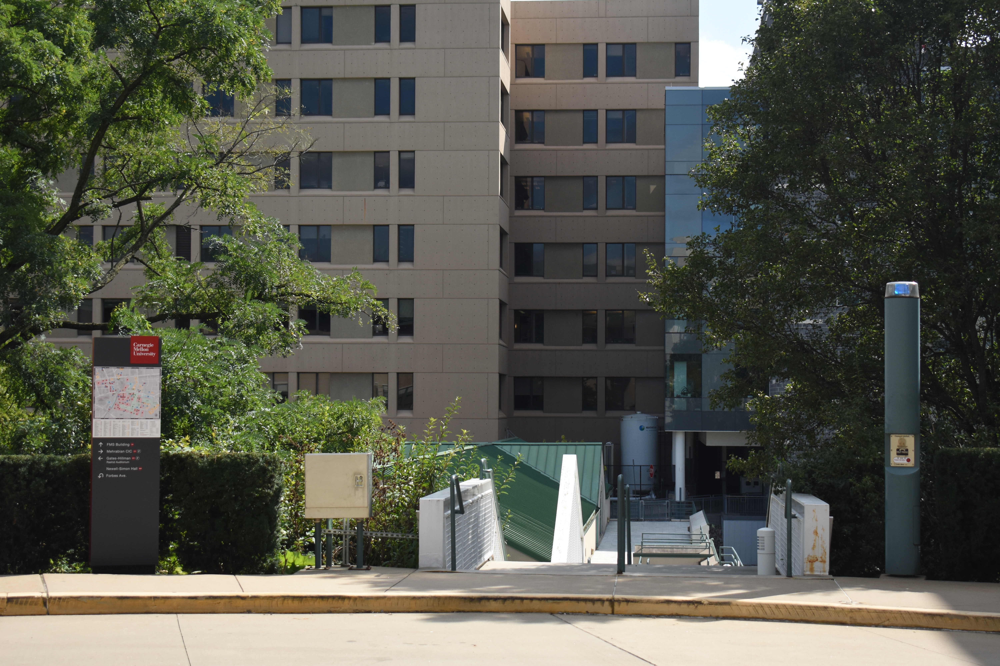

In [35]:
Image(filename="../data/campus.jpg")

In [36]:
Image(filename="../data/campus.png")

## 2.1 Build a Pinhole Camera Obscura

Images of digital obscura camera built from cardboard included below. Gaff tape used to light-proof the corners. Pinholes cut out of thick black darkslide from Polaroid film pack. The small pinhole had the best performance but the highest requirement for light. I chose a lens with a close focus distance (~1ft) because I wanted a short focal length for the camera to allow me to capture an image with a strobe, rather than rely on long exposures for all of my images. 

Screen Size: 12inx12in (304.8mm x 304.8mm)

Focal Length: 12in (304.8mm) - Note: box is cube

FOV: between Normal / Wide Angle (Angle of View = ~53.2 deg)

### Images of Camera Build

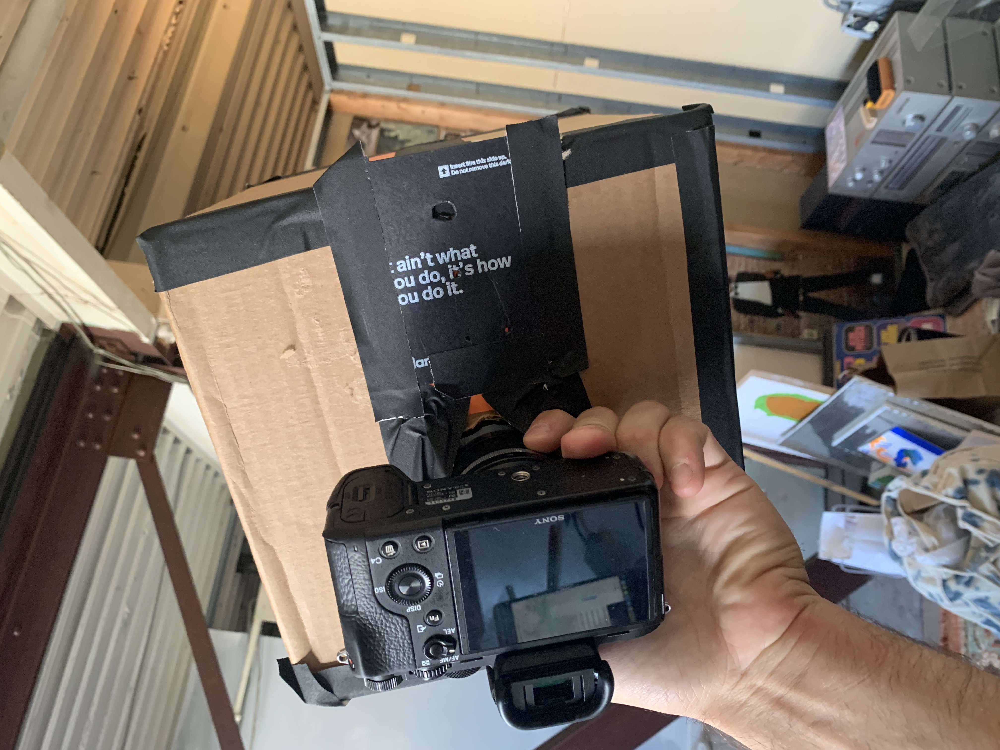

In [37]:
Image(filename="../data/camera1.jpeg")

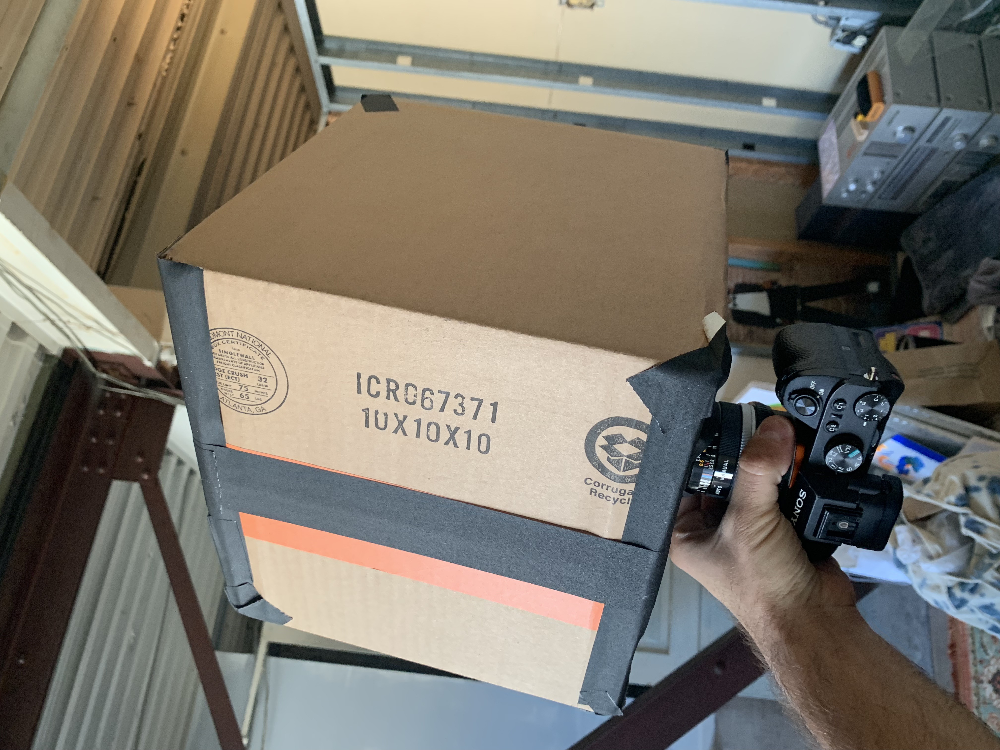

In [38]:
Image(filename="../data/camera2.jpeg")

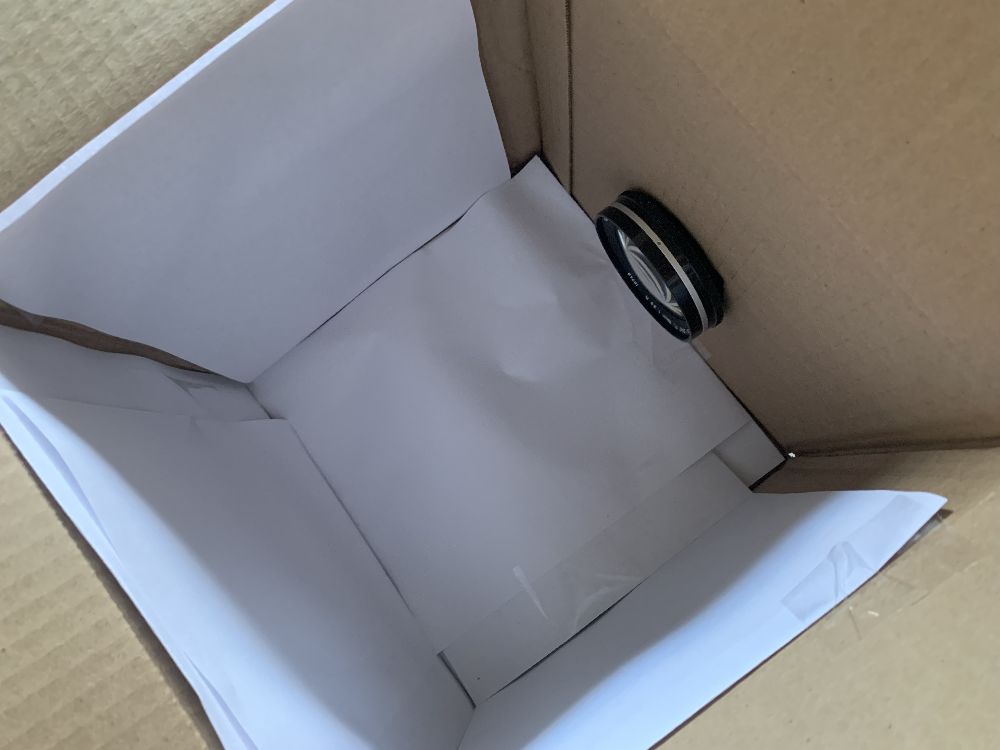

In [39]:
Image(filename="../data/camera3.jpeg")

## 2.2 Use Your Pinhole Camera

In [40]:
'''
It is now time to capture some images with your pinhole camera. We leave it up to you to identify interesting
scenes. Once you have found what you want to photograph, point the pinhole towards it. Figure out the
appropriate settings for the digital camera, then set it to capture an image for 16-30 seconds.
You should capture at least three scenes, each with three different pinhole diameters, for a total of nine
photographs. Some suggested pinhole diameters are 0.1mm (really just a pinprick), 1mm, and 5mm. These
diameters are suggestions: in reality, your pinhole diameter should be about 1.9*sqrt(fλ), where f is the focal
length, and λ is the wavelength of light (550nm on average, for visible light). If you use this formula, then
also go a few millimeters up and down, in order to have three pinhole diameters in total.

Report what pinhole diameters you use, and discuss the differences you observe for the different pinholes.
'''

'\nIt is now time to capture some images with your pinhole camera. We leave it up to you to identify interesting\nscenes. Once you have found what you want to photograph, point the pinhole towards it. Figure out the\nappropriate settings for the digital camera, then set it to capture an image for 16-30 seconds.\nYou should capture at least three scenes, each with three different pinhole diameters, for a total of nine\nphotographs. Some suggested pinhole diameters are 0.1mm (really just a pinprick), 1mm, and 5mm. These\ndiameters are suggestions: in reality, your pinhole diameter should be about 1.9*sqrt(fλ), where f is the focal\nlength, and λ is the wavelength of light (550nm on average, for visible light). If you use this formula, then\nalso go a few millimeters up and down, in order to have three pinhole diameters in total.\n\nReport what pinhole diameters you use, and discuss the differences you observe for the different pinholes.\n'

In [41]:
# Pinhole Calculation
import math
f = 304.8 # mm (12 in)
wavelength = 550 * 10**(-6) #nm to mm
pinhole = round(1.9*math.sqrt(f*wavelength), 2)
print(f'The ideal pinhole according to the equation provided would be ~{pinhole}mm')

The ideal pinhole according to the equation provided would be ~0.78mm


**Small Pinhole Diameter: 1mm**

**Medium Pinhole Diameter: 2.5mm**

**Large Pinhole Diameter: 6mm**

Generally speaking, image sharpness improved as pinhole diameter decreased. Amount of light needed for exposure (exposure time / strobe power) increased as pinhole diameter decreased to maintain the same exposure across the images. Large pinhole (6mm) was unacceptable soft, Medium (2.5mm) was manageable, and Small (1mm) was acceptable so the ideal pinhole diameter for this camera would be between 2mm and 0.5mm.

**Camera Details**

Sony A7II

Canon 19mm FL lens with adapter @ f3.5 & minimum focus distance (MFD)

Strobe (when used) @ 2000W


### Scene 1

#### Small Pinhole

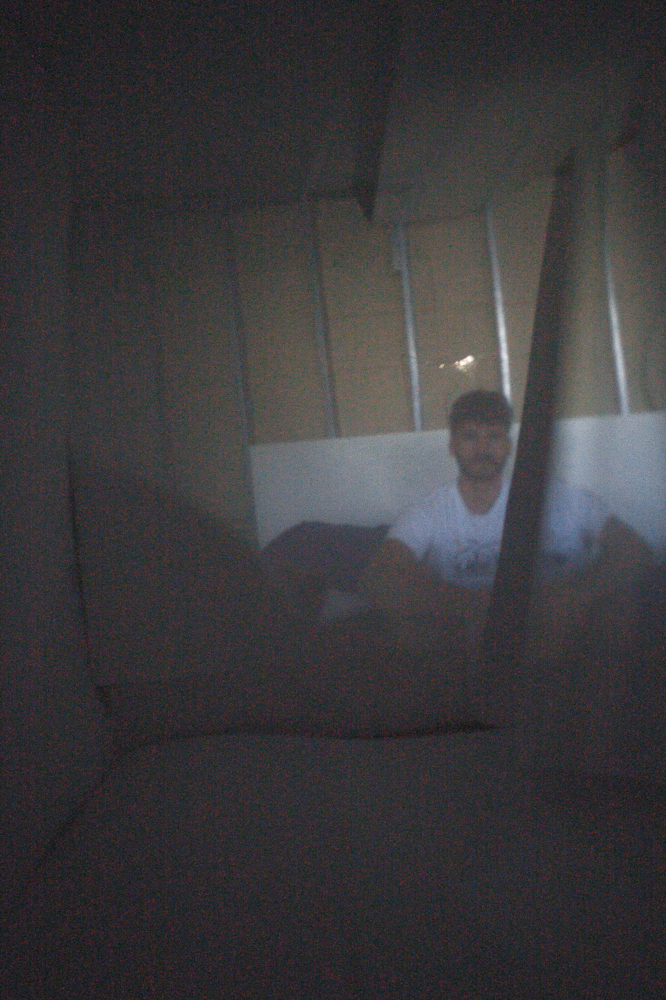

In [21]:
Image(filename="../data/Scene1_SmallPinhole.jpg")

#### Medium Pinhole

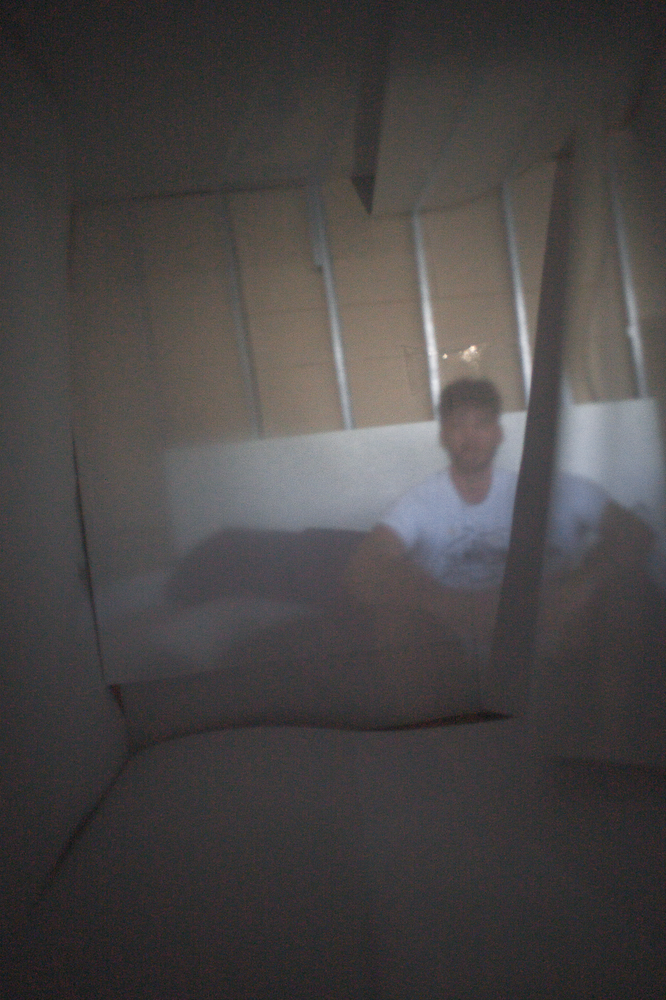

In [52]:
Image(filename="../data/Scene1_MediumPinhole.jpg")

#### Large Pinhole

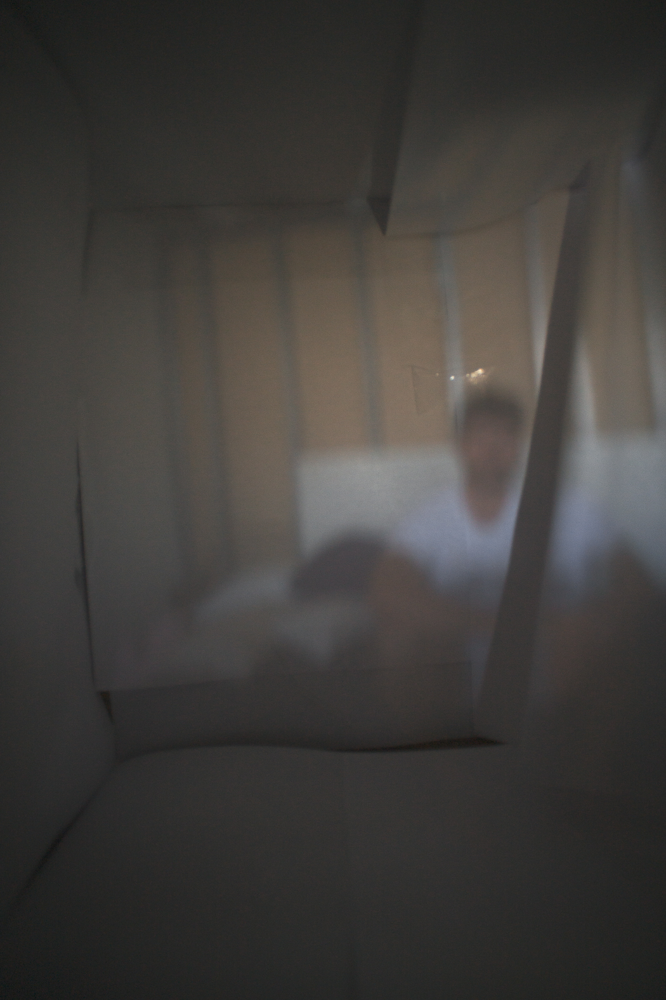

In [53]:
Image(filename="../data/Scene1_LargePinhole.jpg")

### Scene 2

#### Small Pinhole

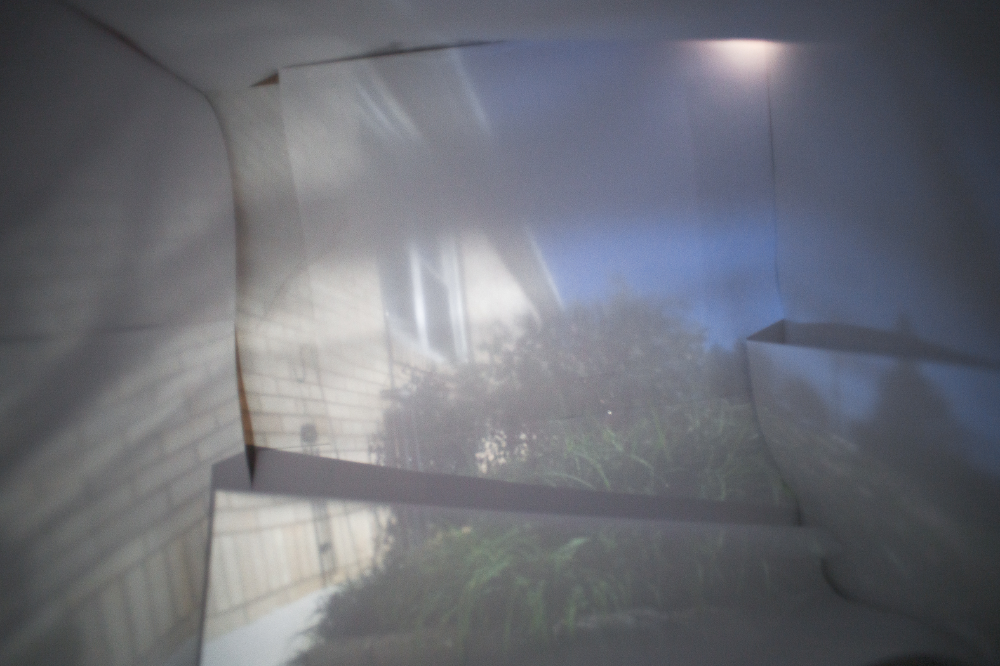

In [54]:
Image(filename="../data/Scene2_SmallPinhole.jpg")

#### Medium Pinhole

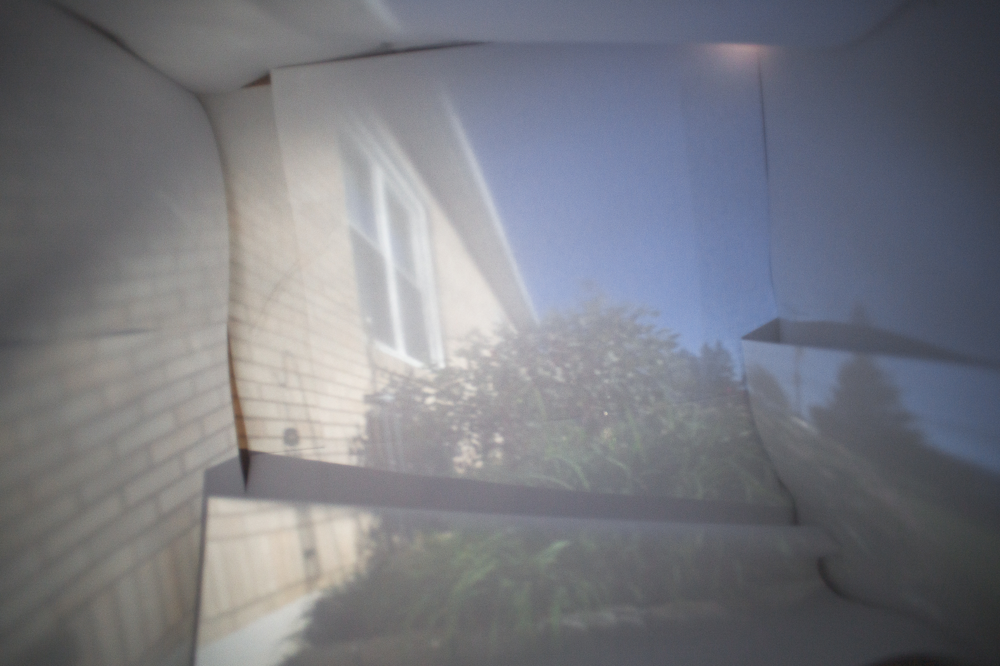

In [55]:
Image(filename="../data/Scene2_MediumPinhole.jpg")

#### Large Pinhole

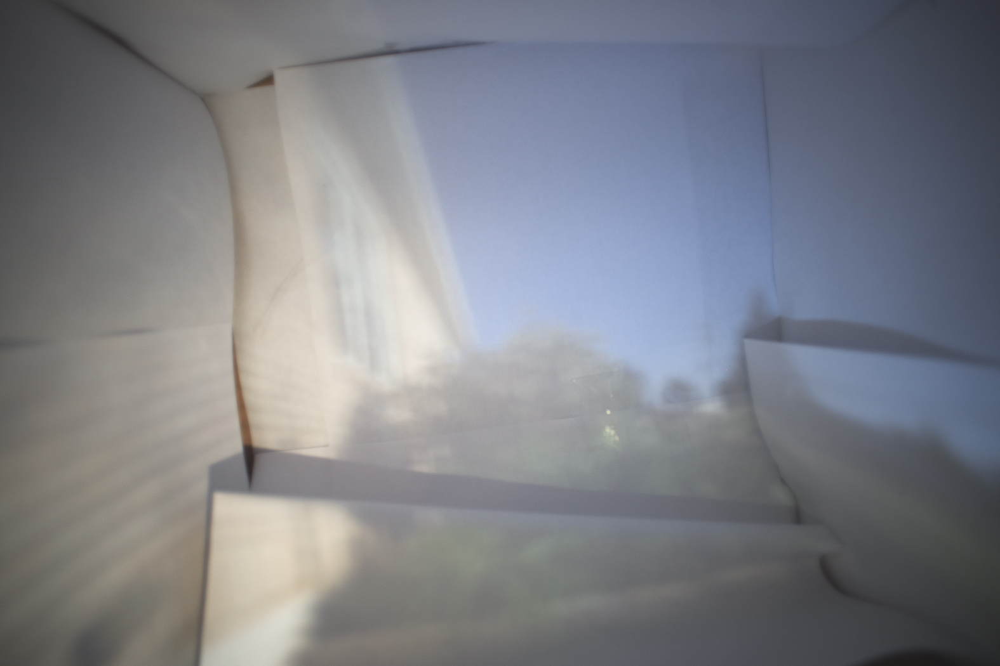

In [56]:
Image(filename="../data/Scene2_LargePinhole.jpg")

### Scene 3

#### Small Pinhole

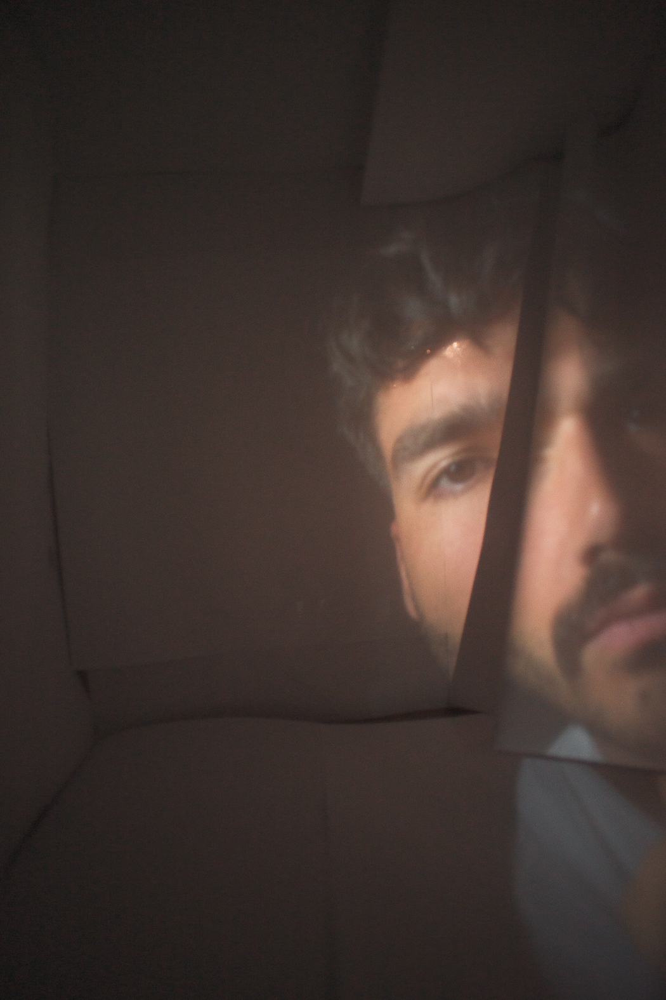

In [57]:
Image(filename="../data/Scene3_SmallPinhole.jpg")

#### Medium Pinhole

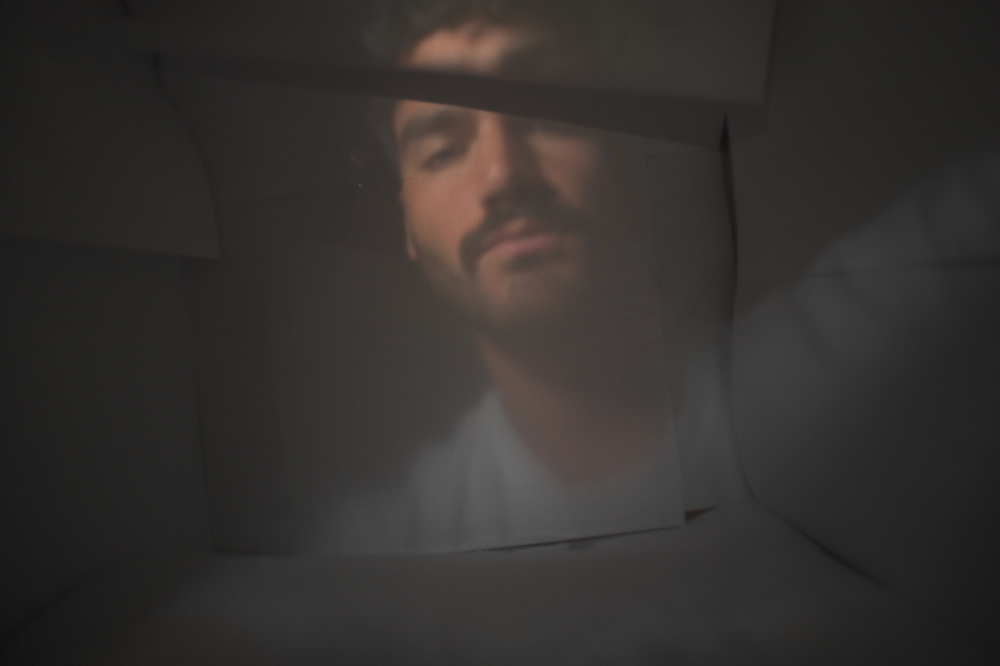

In [22]:
Image(filename="../data/Scene3_MediumPinhole.jpg")

#### Large Pinhole

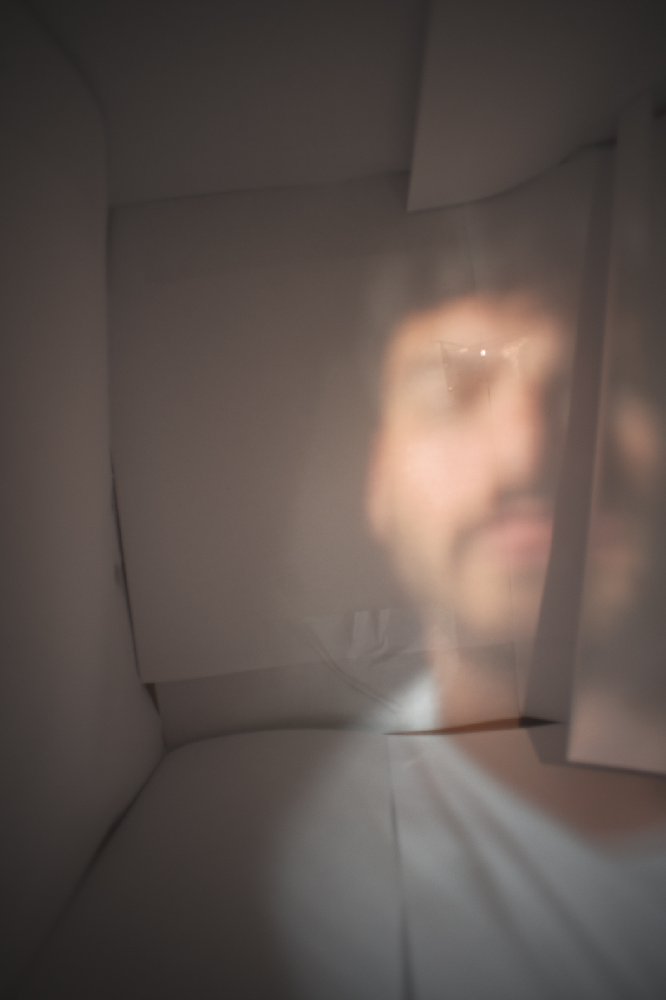

In [23]:
Image(filename="../data/Scene3_LargePinhole.jpg")

## 2.3 Camera Obscura in Room